## First algorithm: Opensignals

In [2]:
import biosignalsnotebooks as bsnb
import numpy as np

data, header = bsnb.load("Sensor data/ECG.h5", get_header=True)

samplingRate = header["sampling rate"]

channel = list(data.keys())[1]
signal = data[channel]

time = bsnb.generate_time(signal)

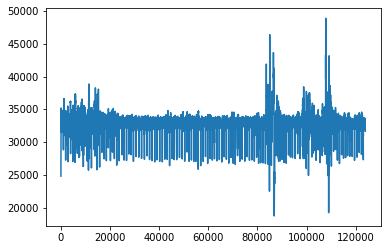

In [2]:
%matplotlib inline
import matplotlib.pyplot as plt

plt.plot(signal)

In [2]:
peaks_opensignal = bsnb.detect_r_peaks(signal, samplingRate, time_units=True, plot_result=True)

In [3]:
intervals = [peaks_opensignal[0][i] - peaks_opensignal[0][i-1] for i in range(1,len(peaks_opensignal[0]))]
rr_intervals = (np.array(intervals) * 1000).astype(int)

In [4]:
print(intervals[:5])
print(rr_intervals[:5])

[0.8260066667204738, 0.9200074254029491, 1.0070081275877933, 0.9980080549479817, 0.5110041243270733]
[ 826  920 1007  998  511]


## Second algorithm: Two moving average

In [22]:
from ecgdetectors import Detectors
dt = Detectors(samplingRate)

r_peaks2 = dt.two_average_detector(signal)

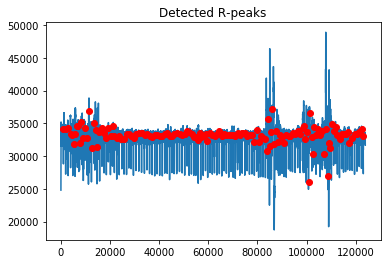

In [10]:
plt.figure()
plt.plot(signal)
plt.plot(r_peaks2, signal[r_peaks2], 'ro')
plt.title('Detected R-peaks')

plt.show()

In [16]:
rr_intervals2 = [r_peaks2[i] - r_peaks2[i-1] for i in range(1,len(r_peaks2))]

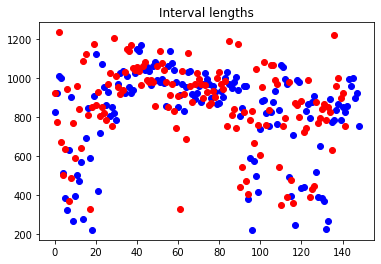

In [21]:
plt.figure()
plt.plot(rr_intervals, 'bo')
plt.plot(rr_intervals2, 'ro')
plt.title('Interval lengths')

plt.show()

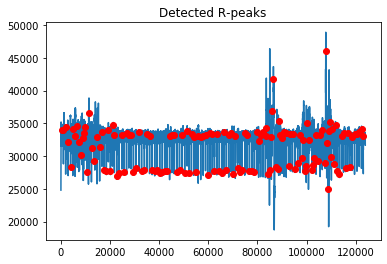

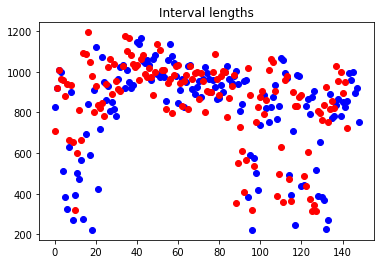

Correlation:  [[1.         0.29134818]
 [0.29134818 1.        ]]


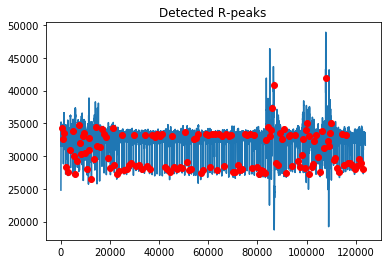

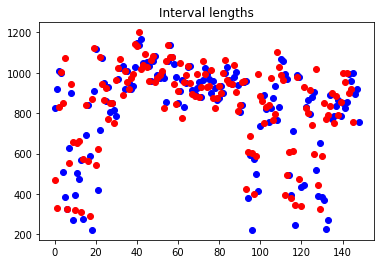

Correlation:  [[1.         0.53300072]
 [0.53300072 1.        ]]


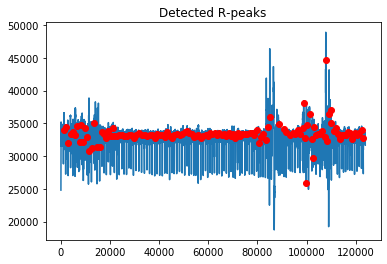

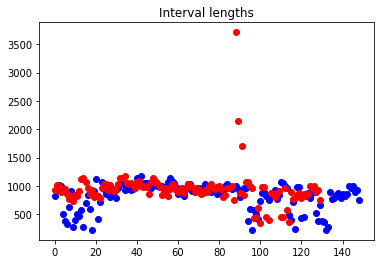

Correlation:  [[1.         0.19192264]
 [0.19192264 1.        ]]


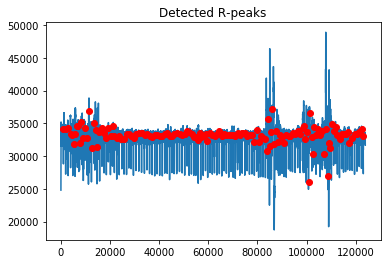

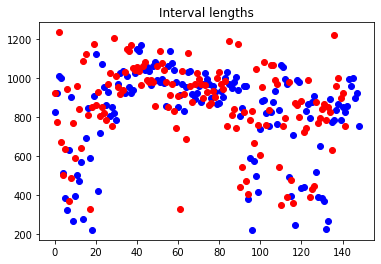

Correlation:  [[1.         0.24461376]
 [0.24461376 1.        ]]


In [35]:
list_det = [dt.hamilton_detector, dt.pan_tompkins_detector, dt.swt_detector, dt.two_average_detector]

for det in list_det:
    r_peaks3 = det(signal)
    
    plt.figure()
    plt.plot(signal)
    plt.plot(r_peaks3, signal[r_peaks3], 'ro')
    plt.title('Detected R-peaks')
    plt.show()
    
    rr_intervals3 = [r_peaks3[i] - r_peaks3[i-1] for i in range(1,len(r_peaks3))]
    
    plt.figure()
    plt.plot(rr_intervals, 'bo')
    plt.plot(rr_intervals3, 'ro')
    plt.title('Interval lengths')

    plt.show()
    
    print("Correlation: ", np.corrcoef(rr_intervals[:len(rr_intervals3)], rr_intervals3))


# Different dataset

In [36]:
import numpy as np

unfiltered_ecg_dat = np.loadtxt("Sensor data/ECG.tsv") 
unfiltered_ecg = unfiltered_ecg_dat[:, 0]
fs = 250

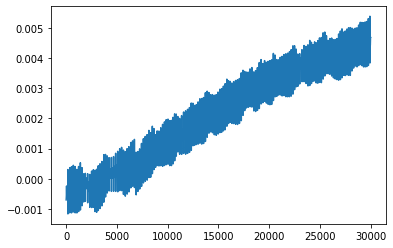

In [37]:
import matplotlib.pyplot as plt

plt.plot(unfiltered_ecg)

In [38]:
time = bsnb.generate_time(unfiltered_ecg)
peaks_opensignal = bsnb.detect_r_peaks(unfiltered_ecg, fs, time_units=True, plot_result=True)

In [47]:
ecg_int_raw = [peaks_opensignal[0][i] - peaks_opensignal[0][i-1] for i in range(1,len(peaks_opensignal[0]))]
ecg_int = (np.array(ecg_int_raw) * 1000).astype(int)

len(ecg_int)

169

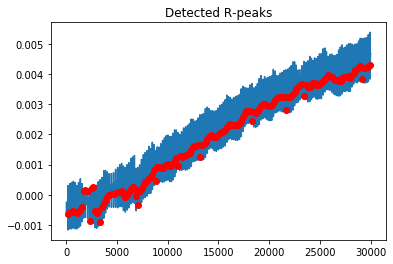

170


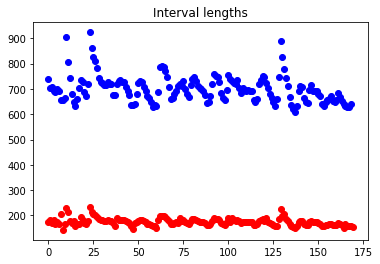

Correlation:  [[1.        0.9337019]
 [0.9337019 1.       ]]


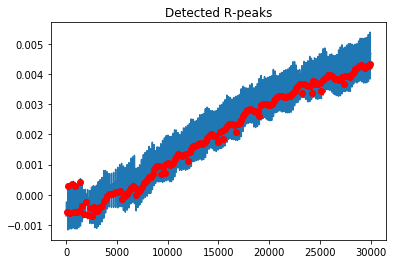

171


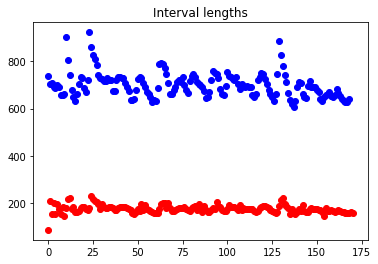

Correlation:  [[1.         0.56111289]
 [0.56111289 1.        ]]


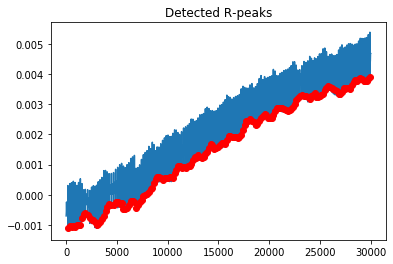

170


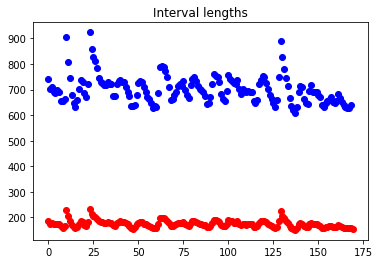

Correlation:  [[1.         0.99714333]
 [0.99714333 1.        ]]


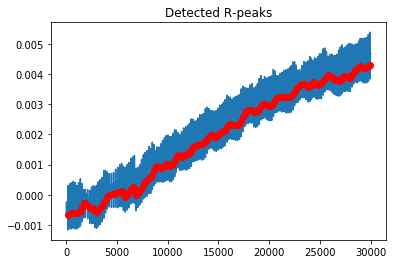

170


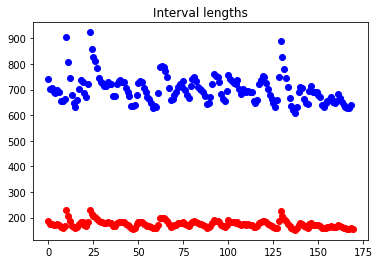

Correlation:  [[1.         0.99708265]
 [0.99708265 1.        ]]


In [48]:
det = Detectors(fs)

list_det = [det.hamilton_detector, det.pan_tompkins_detector, det.swt_detector, det.two_average_detector]

for det in list_det:
    r_peaks3 = det(unfiltered_ecg)
    
    plt.figure()
    plt.plot(unfiltered_ecg)
    plt.plot(r_peaks3, unfiltered_ecg[r_peaks3], 'ro')
    plt.title('Detected R-peaks')
    plt.show()
    
    rr_intervals3 = [r_peaks3[i] - r_peaks3[i-1] for i in range(1,len(r_peaks3))]
    print(len(rr_intervals3))
    
    plt.figure()
    plt.plot(ecg_int, 'bo')
    plt.plot(rr_intervals3, 'ro')
    plt.title('Interval lengths')

    plt.show()
    
    print("Correlation: ", np.corrcoef(ecg_int[:len(rr_intervals3)], rr_intervals3[:len(ecg_int)]))


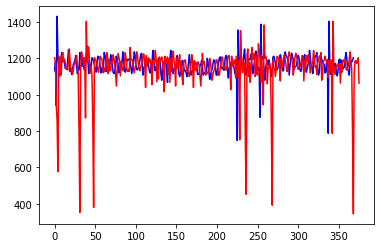

In [115]:
plt.figure()
plt.plot(ecg_int_s, 'b-')
plt.plot(rr_intervals3, 'r-')
plt.show()



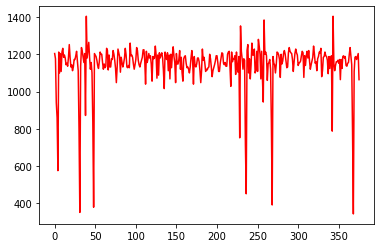

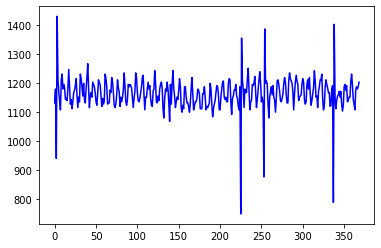

In [116]:
plt.figure()
plt.plot(rr_intervals3, 'r-')
plt.show()

plt.figure()
plt.plot(ecg_int_s, 'b-')
plt.show()


# Real-Time Classification

In [195]:
import pyhrv, hrvanalysis


def calc_features(intervals, samplingRate, pyHRV=True):
    
    features = {}
    
    if pyHRV:
        rr_features = pyhrv.time_domain.nni_parameters(nni=intervals)
        hr_features = pyhrv.time_domain.hr_parameters(nni=intervals)
        rmssd = pyhrv.time_domain.rmssd(nni=intervals)
        freq_features = pyhrv.frequency_domain.welch_psd(nni=intervals, show=False, mode='dev')
        
        features.update({'nni_mean': rr_features['nni_mean'], 'hr_mean': hr_features['hr_mean'], 
                        'hr_std': hr_features['hr_std'], 'rmssd': rmssd['rmssd'],
                        'lf': freq_features[0]['fft_abs'][1], 'hf': freq_features[0]['fft_abs'][2],
                        'LF/HF ratio': freq_features[0]['fft_ratio']})
        
 
    else:
        time_features = hrvanalysis.get_time_domain_features(intervals)
        freq_features = hrvanalysis.get_frequency_domain_features(intervals)

        features.update({'nni_mean': time_features['mean_nni'], 'hr_mean': time_features['mean_hr'], 
                        'hr_std': time_features['std_hr'], 'rmssd': time_features['rmssd'],
                        'lf': freq_features['lf'], 'hf': freq_features['hf'],
                        'LF/HF ratio': freq_features['lf_hf_ratio']})
        
    return features

{'nni_mean': 1164.0756756756757, 'hr_mean': 51.677875591044554, 'hr_std': 2.8866211656829193, 'rmssd': 80.76839651335635, 'lf': 1073.2386002102262, 'hf': 1065.2574752969178, 'LF/HF ratio': 1.0074922026818762}
0  windows calculated
{'nni_mean': 1164.572972972973, 'hr_mean': 51.659219479951474, 'hr_std': 2.91306685198763, 'rmssd': 81.57394769832726, 'lf': 1073.0819518049038, 'hf': 1088.5616948007844, 'LF/HF ratio': 0.9857796364966586}
{'nni_mean': 1161.789757412399, 'hr_mean': 52.06918337488115, 'hr_std': 8.094808609733427, 'rmssd': 91.62957152785545, 'lf': 1073.1632855435873, 'hf': 1092.0487058470098, 'LF/HF ratio': 0.9827064303979238}
{'nni_mean': 1162.167115902965, 'hr_mean': 51.95524435570403, 'hr_std': 6.223676669744897, 'rmssd': 89.73522614230608, 'lf': 1072.8810225790326, 'hf': 1108.4516622666135, 'LF/HF ratio': 0.9679096158195618}
{'nni_mean': 1159.731182795699, 'hr_mean': 52.39490884664329, 'hr_std': 10.294485080810162, 'rmssd': 90.8250295008347, 'lf': 1075.0871848690365, 'hf': 

{'nni_mean': 1160.733153638814, 'hr_mean': 51.952067542867155, 'hr_std': 5.058297724583169, 'rmssd': 87.30239462986172, 'lf': 1052.7203196896555, 'hf': 1250.118296286867, 'LF/HF ratio': 0.8420965622345278}
{'nni_mean': 1162.4864864864865, 'hr_mean': 51.74424417884495, 'hr_std': 2.838158971927593, 'rmssd': 75.09488126638142, 'lf': 1054.4913770222843, 'hf': 1236.9245680085987, 'LF/HF ratio': 0.8525106577193912}
40  windows calculated
{'nni_mean': 1161.6432432432432, 'hr_mean': 51.77619553849819, 'hr_std': 2.795915534922692, 'rmssd': 74.32441887557825, 'lf': 1053.0689991493125, 'hf': 1230.1133375595834, 'LF/HF ratio': 0.8560747753849183}
{'nni_mean': 1161.5309973045821, 'hr_mean': 51.78103444155191, 'hr_std': 2.793689893613846, 'rmssd': 74.22507771745451, 'lf': 1053.0689991493236, 'hf': 1230.1133375596073, 'LF/HF ratio': 0.8560747753849107}
{'nni_mean': 1162.0053908355794, 'hr_mean': 51.76611742574676, 'hr_std': 2.8398043805873385, 'rmssd': 75.65154827732712, 'lf': 1049.3296016352338, 'hf

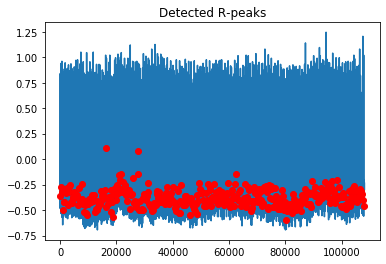

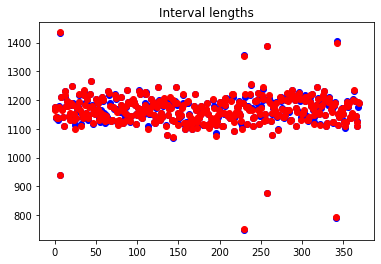

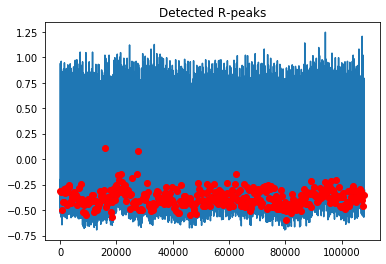

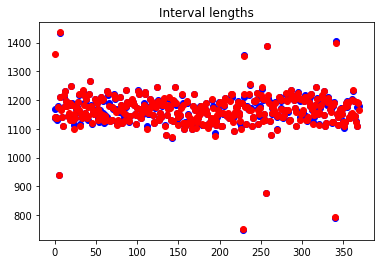

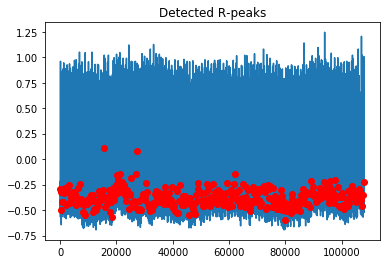

...

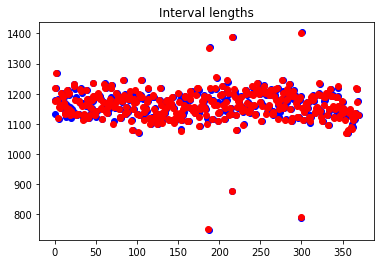

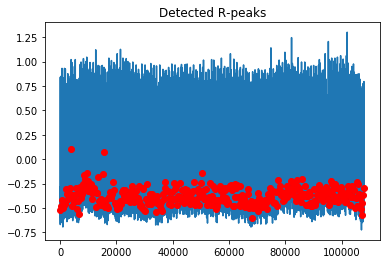

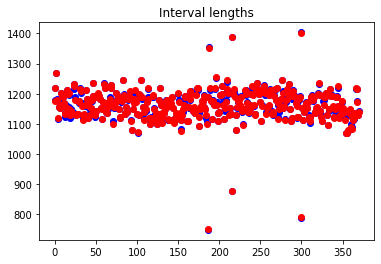

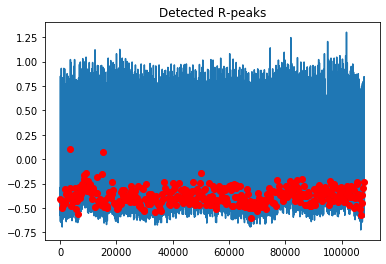

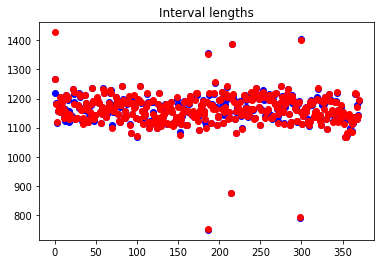

In [200]:
import wfdb

sig, fields = wfdb.rdsamp("Sensor data/100")
ecg_30min = sig[:, 0]  

sr = fields["fs"]
window_length = 5 * 60 * sr

det = Detectors(fs)
list_det = [det.swt_detector]

corr_matrix = [0] * len(list_det)

for i in range(0, int((len(ecg_30min) - window_length) / (sr * 30)) + 1 ):
    ecg_window = ecg_30min[i*fs:i*fs+window_length]
    
    peaks_opensignal = bsnb.detect_r_peaks(ecg_window, fs, time_units=True, plot_result=False)
    ecg_int_ms = [peaks_opensignal[0][i] - peaks_opensignal[0][i-1] for i in range(1,len(peaks_opensignal[0]))]
    ecg_int_s = (np.array(ecg_int_ms) * 1000).astype(int)
    
    #print("detectors")

    for pos, det in enumerate(list_det):
        r_peaks3 = [i - 1 for i in det(ecg_window)]
        
    
        ## r-peaks are timestamps -> divide by 250 to get time in ms, multiply by 1000 to get time in s
        rr_intervals3 = [4 * (r_peaks3[i] - r_peaks3[i-1]) for i in range(1,len(r_peaks3))]


        corr = np.corrcoef(ecg_int_s[:len(rr_intervals3)], rr_intervals3[:len(ecg_int_s)])

        corr_matrix[pos] += abs(corr)
        
        pyhrv_feat = calc_features(intervals=rr_intervals3, samplingRate=fs, pyHRV=True)
        
        print(pyhrv_feat)
        
    if i%5 == 0:
        print(i, " windows calculated")

In [199]:
corr_matrix

[array([[5.        , 2.02640036],
        [2.02640036, 5.        ]])]

# Determine best algorithm

In [148]:
def sort_MIT_annotations(ann):
    beat_labels = ['N', 'L', 'R', 'B', 'A', 'a', 'J', 'S', 'V', 'r', 'F', 'e', 'j', 'n', 'E', '/', 'f', 'Q', '?']
    in_beat_labels = np.in1d(ann.symbol, beat_labels)

    sorted_anno = ann.sample[in_beat_labels]
    sorted_anno = np.unique(sorted_anno)

    return sorted_anno

In [170]:
ann = wfdb.rdann('Sensor data/100', 'atr')   

anno = sort_MIT_annotations(ann)   

len(anno)


2273

2272


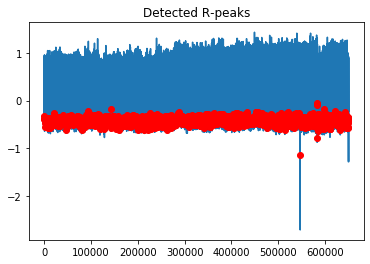

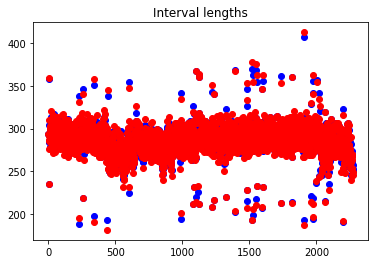

Correlation:  [[1.         0.95678131]
 [0.95678131 1.        ]]
2272


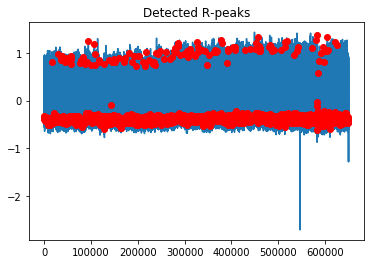

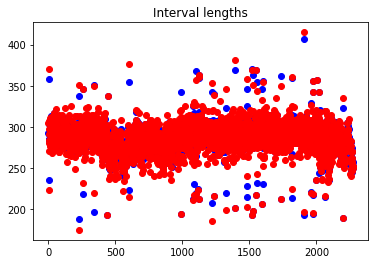

Correlation:  [[1.         0.88154555]
 [0.88154555 1.        ]]
2272


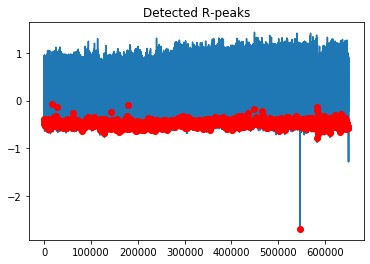

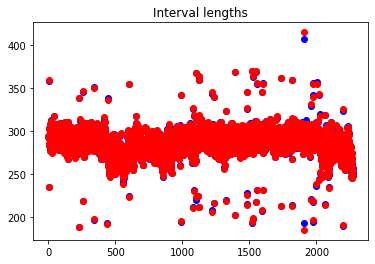

Correlation:  [[1.         0.99741265]
 [0.99741265 1.        ]]
2308


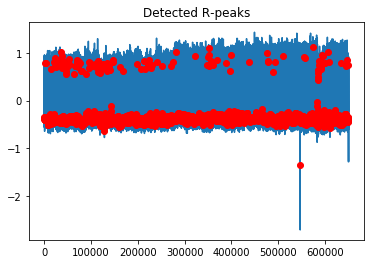

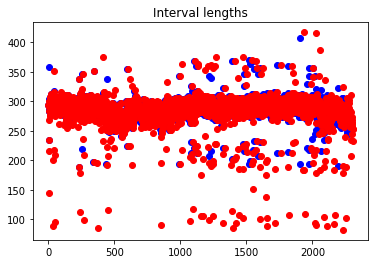

Correlation:  [[1.         0.07436219]
 [0.07436219 1.        ]]


In [169]:
det = Detectors(fs)

list_det = [det.hamilton_detector, det.pan_tompkins_detector, det.swt_detector, det.two_average_detector]

for det in list_det:
    pyecg_peaks = det(ecg_30min)
    print(len(pyecg_peaks))
    
    plt.figure()
    plt.plot(ecg_30min)
    plt.plot(pyecg_peaks, ecg_30min[pyecg_peaks], 'ro')
    plt.title('Detected R-peaks')
    plt.show()
    
    pyecg_intervals = [pyecg_peaks[i] - pyecg_peaks[i-1] for i in range(1,len(pyecg_peaks))]
    
    anno_intervals = [anno[i] - anno[i-1] for i in range(1,len(anno))]
    
    plt.figure()
    plt.plot(anno_intervals, 'bo')
    plt.plot(pyecg_intervals, 'ro')
    plt.title('Interval lengths')

    plt.show()
    
    print("Correlation: ", np.corrcoef(anno_intervals[:len(pyecg_intervals)], pyecg_intervals[:len(anno_intervals)]))


2272


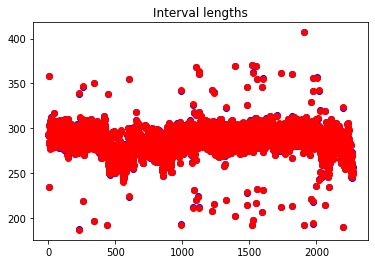

Correlation:  [[1.         0.99942744]
 [0.99942744 1.        ]]


In [191]:
opensig_peaks = bsnb.detect_r_peaks(ecg_30min, fs, time_units=True, plot_result=True)
print(len(opensig_peaks[0]))
    
opensig_int = [opensig_peaks[0][i] - opensig_peaks[0][i-1] for i in range(1,len(opensig_peaks[0]))]
opensig_intervals = (np.array(opensig_int) * 250).astype(int)
    
anno_intervals = [anno[i] - anno[i-1] for i in range(1,len(anno))]
    
plt.figure()
plt.plot(anno_intervals, 'bo')
plt.plot(opensig_intervals, 'ro')
plt.title('Interval lengths')

plt.show()
    
print("Correlation: ", np.corrcoef(anno_intervals[:len(opensig_intervals)], opensig_intervals[:len(anno_intervals)]))
 

# Algorithm for real-time feature calculation

In [194]:
## Options for feature detection: Aura healthcare, PyHRV